In [ ]:
!git clone https://github.com/Narasimhan07/cv-session.git         # I have already cloned it here.
%cd cv-session/

Cloning into 'cv-session'...
remote: Enumerating objects: 84, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 84 (delta 4), reused 2 (delta 0), pack-reused 74
Unpacking objects: 100% (84/84), done.
/content/cv-session


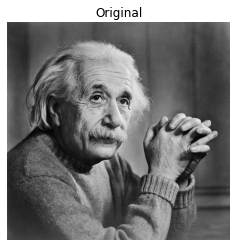

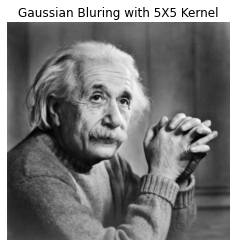

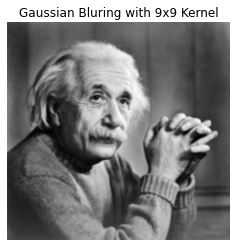

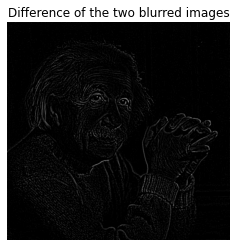

In [ ]:
"""
Edge Detection using Different Gaussian Kernels
Problem Statement: Perform Gaussian Blurring with kernels of size 5x5 and 9x9 and find their difference and see the output.
"""

import cv2
import numpy as np
from matplotlib import pyplot as plt
# reading einstein.jpg from media file under cv-session/
img = cv2.imread("media/einstein.jpg",0)
gaus_blur_img_5 = cv2.GaussianBlur(img,(5,5),0)
gaus_blur_img_9 = cv2.GaussianBlur(img,(9,9),0)
# calculating the gaussian kernels with which we got the blurred images
kernel_5_5 = cv2.getGaussianKernel(5,0)
kernel_5_5 = kernel_5_5*kernel_5_5.transpose(1,0)
kernel = np.zeros((9,9))
# to allow for broadcasting while finding dfifference in kernels
for i in range(0,5):
  for j in range(0,5):
    kernel[i+2][j+2] = kernel_5_5[i][j]      # now kernel is the new 5X5 Gaussian Kernel, not kernel_5_5
kernel_9_9 = cv2.getGaussianKernel(9,0)
kernel_9_9 = kernel_9_9*kernel_9_9.transpose(1,0)
#finding the kernel corresponding to the difference of the two images
kernel_difference = kernel - kernel_9_9     # the new 5x5 kernel we are using
# finding the difference of two images
difference = cv2.filter2D(img,-1,kernel_difference)
# showing the images
plt.figure(),plt.imshow(img,cmap='gray'),plt.title('Original'),plt.axis("off")
plt.figure(),plt.imshow(gaus_blur_img_5,cmap='gray'),plt.title('Gaussian Bluring with 5X5 Kernel'),plt.axis("off")
plt.figure(),plt.imshow(gaus_blur_img_9,cmap='gray'),plt.title('Gaussian Bluring with 9x9 Kernel'),plt.axis("off")
plt.figure(),plt.imshow(difference,cmap='gray'),plt.title('Difference of the two blurred images'),plt.axis("off")
plt.show()

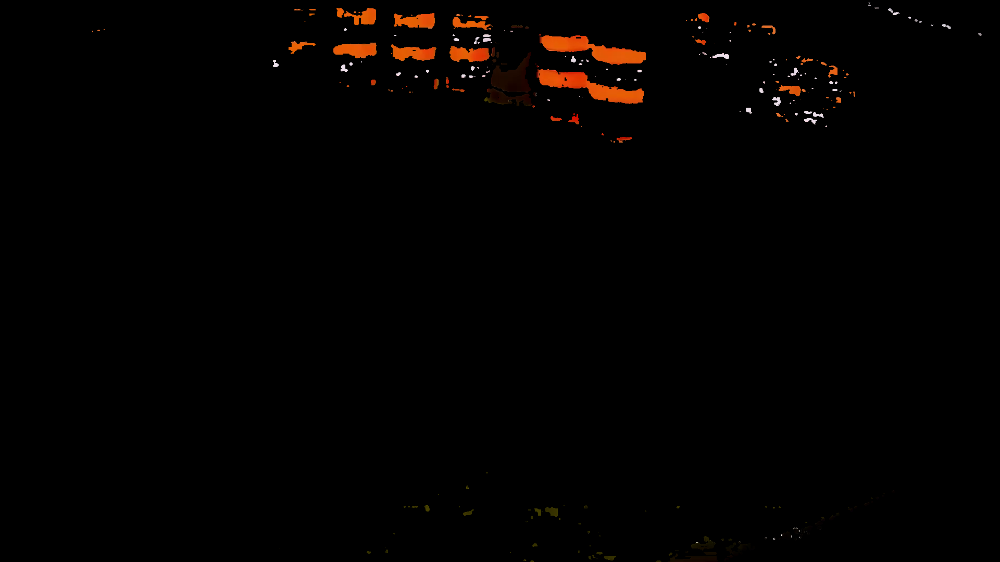

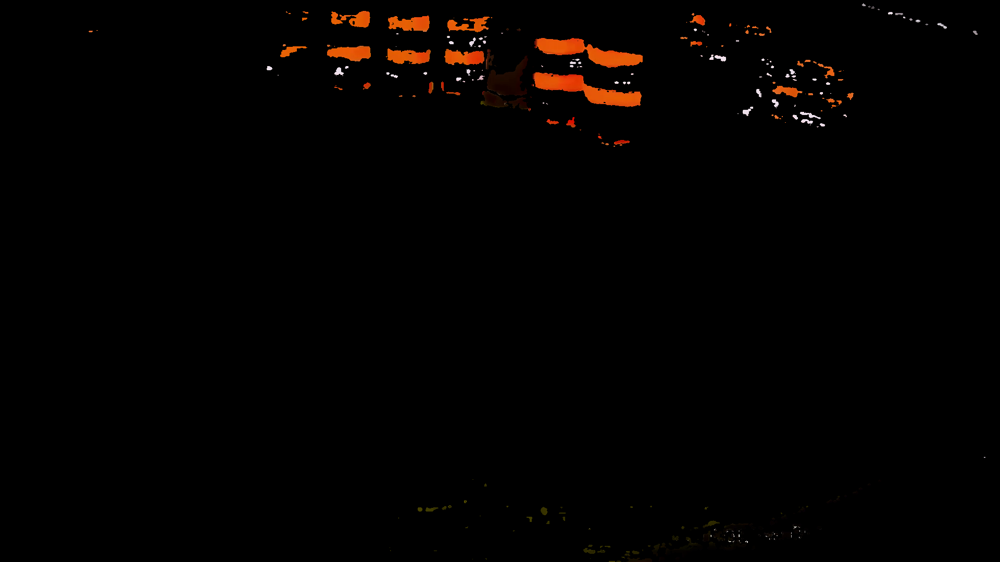

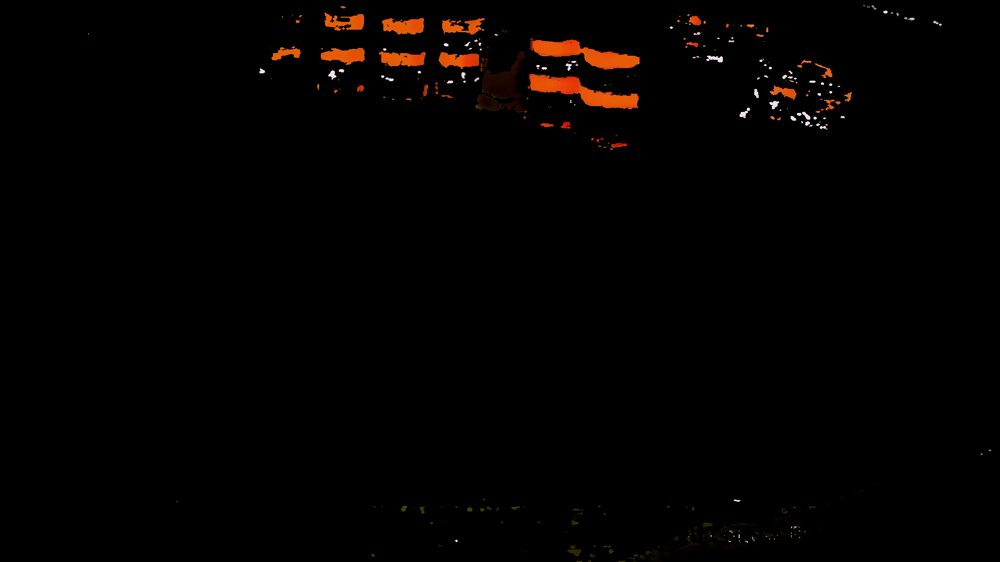

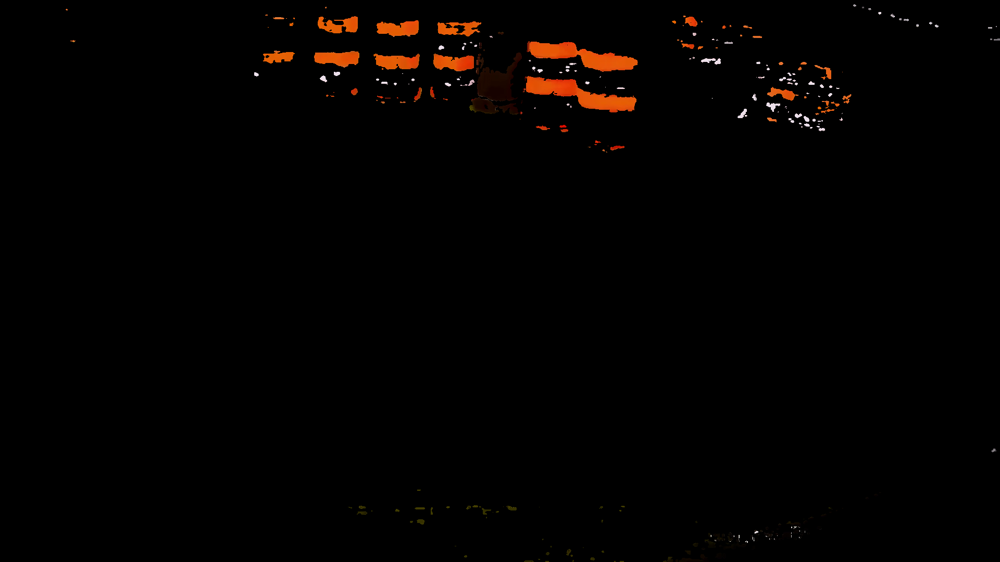

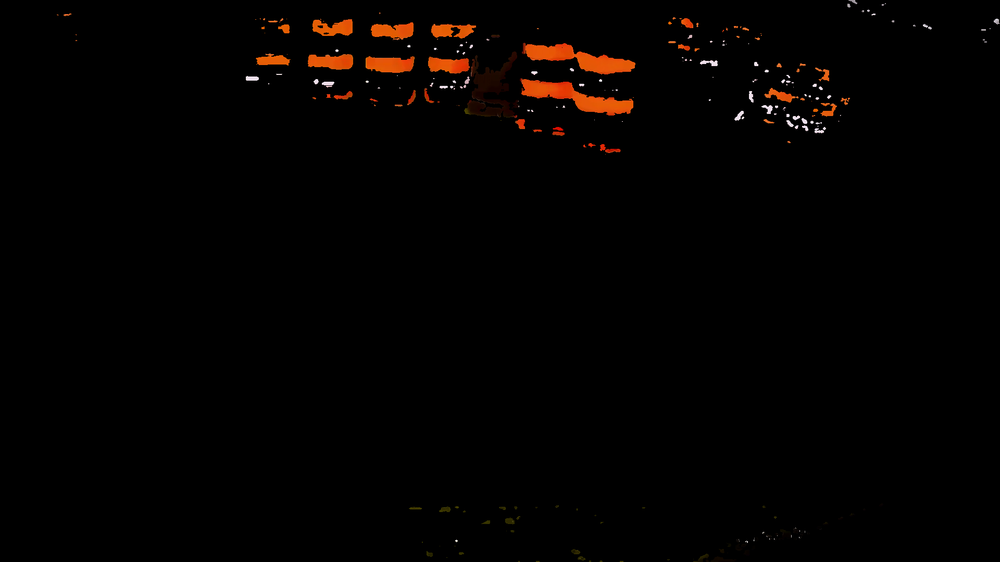

...

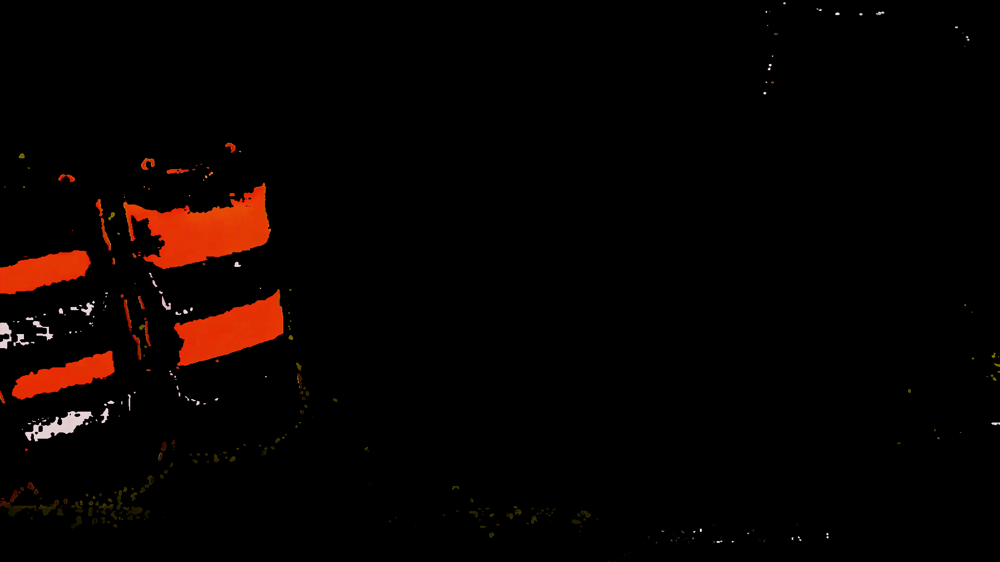

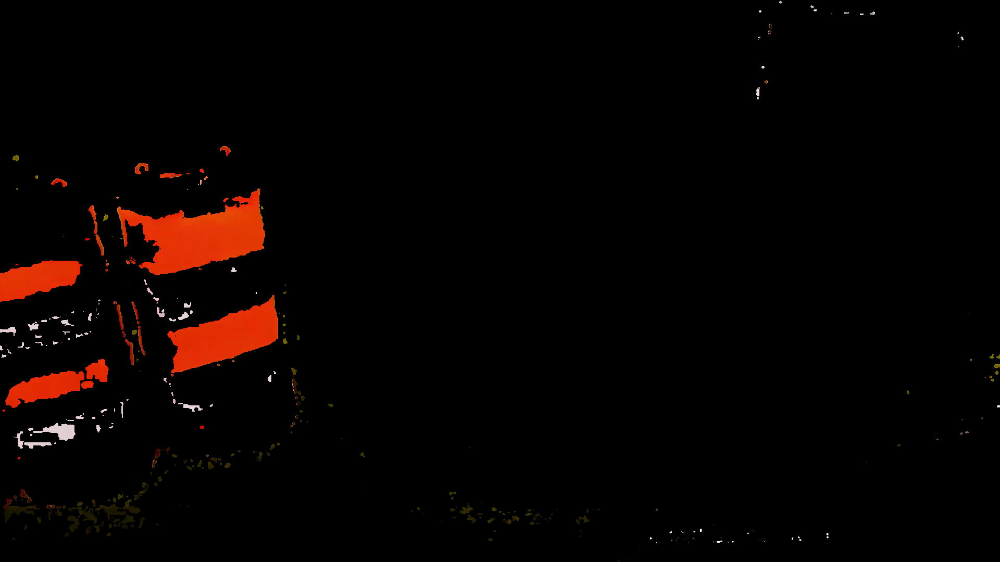

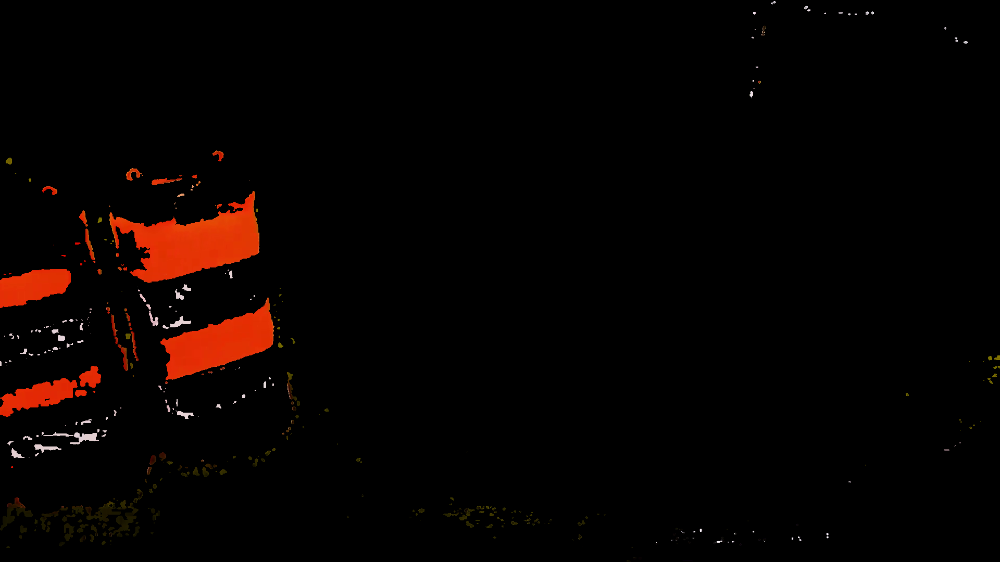

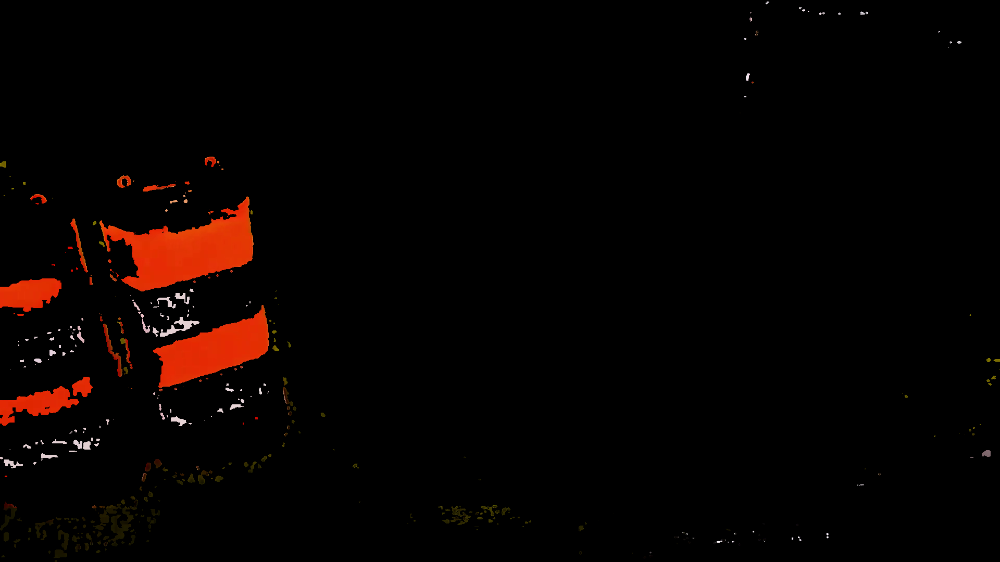

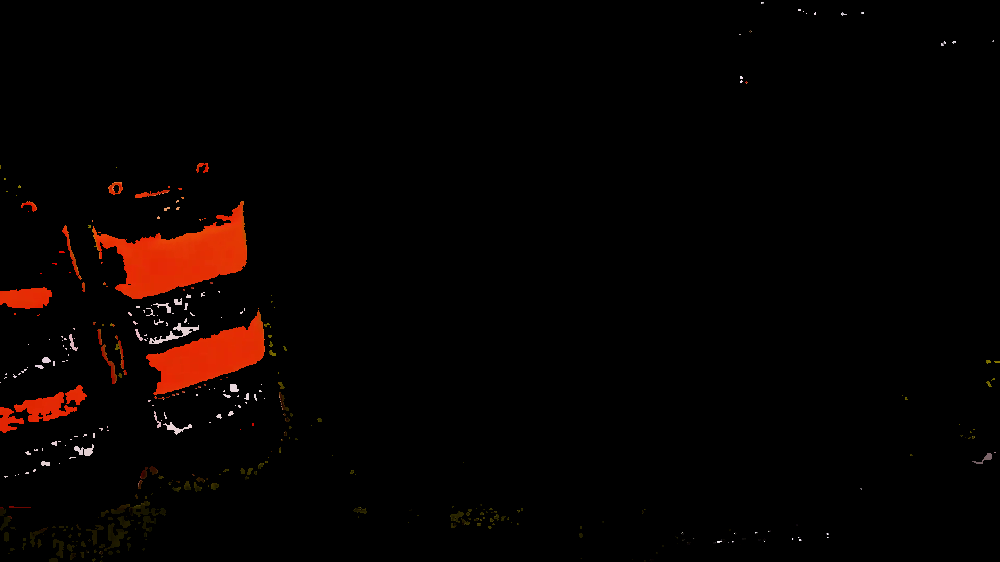

error: ignored

In [ ]:
"""
Problem 2: The task is to recognise the orange and white barrels in the video https://www.youtube.com/watch?v=A9BVr7kltl8. 
You will be using histogram backprojection to do so. Try to understand how 'cv2.calcBackProject()' works for this.
I have used a smaller version of this video and done this question. It is sample_video.mp4 under media files.
"""

import cv2
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
capture = cv2.VideoCapture("media/sample_video.mp4")

while(True) :
  ret, frame = capture.read()
  roi = cv2.imread("media/template__barrel.jpg")
  hsv = cv2.cvtColor(roi,cv2.COLOR_BGR2HSV)

  hsvt = cv2.cvtColor(frame,cv2.COLOR_BGR2HSV)   # the last execution will show an error because there is no image stored in frame once video is over 

  # calculating object histogram
  roihist = cv2.calcHist([hsv],[0, 1], None, [180, 256], [0, 180, 0, 256] )

  # normalize histogram and apply backprojection
  cv2.normalize(roihist,roihist,0,255,cv2.NORM_MINMAX)
  dst = cv2.calcBackProject([hsvt],[0,1],roihist,[0,180,0,256],1)

  # Now convolute with circular disc
  disc = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
  cv2.filter2D(dst,-1,disc,dst)

  # threshold and binary AND  # we get only the barrels and remaining area blacked if we use bitwise_and. If we use bitwise_or we get 
  # the barrel area with white patches and remaining picture as the same. 
  ret, thresh = cv2.threshold(dst,50,255,0)
  thresh = cv2.merge((thresh,thresh,thresh))
  res = cv2.bitwise_and(frame,thresh)


  cv2_imshow(res)
  if cv2.waitKey(1000) & 0xFF == ord('q') :
    break;
capture.release()
cv2.destroyAllWindows()

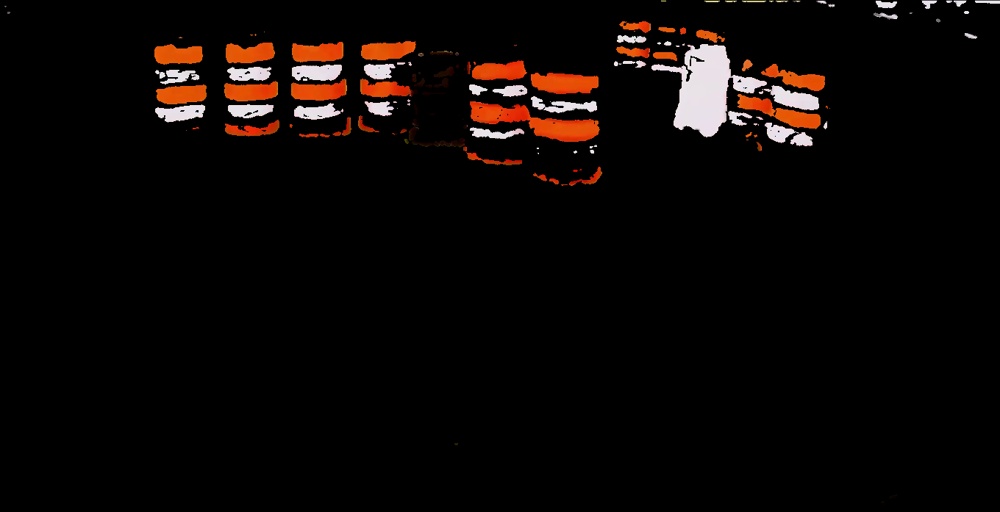

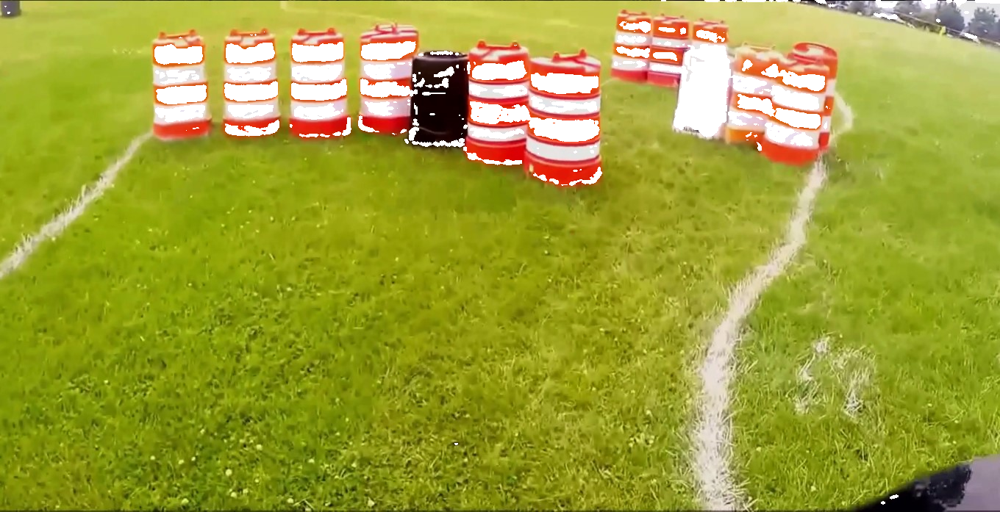

In [ ]:
# This code is for a particular image from the video. 


import cv2
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
roi = cv2.imread("media/template__barrel.jpg")
hsv = cv2.cvtColor(roi,cv2.COLOR_BGR2HSV)

target = cv2.imread("media/samplePhoto.jpg")
hsvt = cv2.cvtColor(target,cv2.COLOR_BGR2HSV)

# calculating object histogram
roihist = cv2.calcHist([hsv],[0, 1], None, [180, 256], [0, 180, 0, 256] )

# normalize histogram and apply backprojection
cv2.normalize(roihist,roihist,0,255,cv2.NORM_MINMAX)
dst = cv2.calcBackProject([hsvt],[0,1],roihist,[0,180,0,256],1)

# Now convolute with circular disc
disc = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
cv2.filter2D(dst,-1,disc,dst)

# threshold and binary AND
ret,thresh = cv2.threshold(dst,50,255,0)
thresh = cv2.merge((thresh,thresh,thresh))
res = cv2.bitwise_and(target,thresh)
res1 = cv2.bitwise_or(target,thresh)


cv2_imshow(res)
cv2_imshow(res1)
"""
First image is bitwise_and and second image is bitwise_or.
"""